In [21]:
import pandas as pd
from scipy.stats import spearmanr
import numpy as np
from sklearn.model_selection import train_test_split
import os
import matplotlib.pyplot as plt
from scipy import stats
from PIL import Image

In [2]:
categories = ['banana','beach','car','church','lighthouse','mountain','mug','plane']
path='../Analysis/human_rating_bycat'

In [3]:
for i, cate in enumerate(categories):
    col = [cate+'_'+str(i+1) for i in range(16)]
    new = pd.read_csv(path+'/'+cate+'.csv')
    new.columns = col
    if i == 0:
        old = new
    else:
        old = pd.concat([old,new],axis=1)
df = old

(Test) Use quantiles to remove outliers 

In [4]:
quantile_low = df.quantile(0.1)
quantile_high = df.quantile(0.9)
iqr = quantile_high - quantile_low

In [5]:
outliers = (df < quantile_low) | (df > quantile_high)
df_new = df[outliers.sum(axis=1) <= 12]

Compute 7 scorse and sort images by order in survey

In [6]:
alexnet_df=pd.read_csv('alexnet_scores_wordnet_id_closest_label.csv',index_col=0)
alexnet_df['typicality_score'] = np.round(alexnet_df['closest_prob'] * 100,2)
alexnet_df['7_score']= np.round(alexnet_df['typicality_score']*7/100,2)
alexnet_df['type'] = alexnet_df['type'].apply(lambda x: x.lower())

In [7]:
alexnet_df['number'] = alexnet_df['dir'].apply(lambda x: int(x.split('\\')[-1].split('.')[0]))
alexnet_df = alexnet_df.sort_values(['type','number']).reset_index(drop=True)

# Correlation with human ratings

Changes from original script: 
1. Use spearman rank correlation instead of pearson
2. Compute average human ratings first, and then compute correlation with neural net typicality scores

without dropping outliers

In [8]:
final_corr = dict()
for t in np.unique(alexnet_df['type']):
    col_names = [t + '_' + str(i+1) for i in range(16)]
    human_ratings = df[col_names] 
    net_ratings = alexnet_df[alexnet_df['type'] == t] 
    
    human_scores = human_ratings.mean().values
    net_scores = net_ratings['7_score'].values
#     net_scores = net_ratings['typicality_score'].values
    
    coef, p=stats.spearmanr(human_scores, net_scores)
#     coef, p=stats.pearsonr(human_scores, net_scores)
    final_corr[t]=coef
    print(f'{t}: ', final_corr[t])

banana:  0.3004418262150221
beach:  0.2058823529411765
car:  0.24705882352941175
church:  0.351729307878893
lighthouse:  0.4223695036035242
mountain:  0.6975719327807334
mug:  0.06484894907460316
plane:  0.528329797190471


In [9]:
print(np.mean(list(final_corr.values())))

0.3522790616517294


after dropping outliers

In [10]:
final_corr = dict()
for t in np.unique(alexnet_df['type']):
    col_names = [t + '_' + str(i+1) for i in range(16)]
    
    human_ratings = df_new[col_names] 
    net_ratings = alexnet_df[alexnet_df['type'] == t] 
    
    human_scores = human_ratings.mean().values
    net_scores = net_ratings['7_score'].values
    coef, p=stats.spearmanr(human_scores, net_scores)
    final_corr[t]=coef
    print(f'{t}: ', final_corr[t])

banana:  0.28718703976435933
beach:  0.17378516637919467
car:  0.21649508015035274
church:  0.3752760397871034
lighthouse:  0.41857048948152953
mountain:  0.6968356206287721
mug:  -0.042804532956051446
plane:  0.42773047454949503


In [11]:
print(np.mean(list(final_corr.values())))

0.3191344222230944


# Plot graphs

In [36]:
alexnet_df['human_score'] = np.array(df.apply(np.mean, axis = 0))

In [87]:
alexnet_df

,type,dir,id_labels,readable_labels,similarity_score,closest_id_label,closest_similarity_score,closest_readable_label,closest_prob,typicality_score,7_score,number,human_score
0,banana,../Image/All_Cropped\Banana\1.jpg,"{'07753592-n': 0.9909868836402893, '07717410-n...","{'banana': 0.9909868836402893, 'acorn squash':...","{'07753592-n': 1.0, '07717410-n': 0.1428571428...",07753592-n,1.000000,banana,0.990987,99.10,6.94,1,6.555556
1,banana,../Image/All_Cropped\Banana\2.jpg,"{'03476684-n': 0.2392529845237732, '02999410-n...","{'hair slide': 0.2392529845237732, 'chain': 0....","{'03476684-n': 0.06666666666666667, '02999410-...",03476684-n,0.066667,hair slide,0.239253,23.93,1.68,2,6.083333
2,banana,../Image/All_Cropped\Banana\3.jpg,"{'03065424-n': 0.6192737817764282, '03532672-n...","{'coil': 0.6192737817764282, 'hook': 0.0780839...","{'03065424-n': 0.09090909090909091, '03532672-...",07753592-n,1.000000,banana,0.032153,3.22,0.23,3,6.194444
3,banana,../Image/All_Cropped\Banana\4.jpg,"{'07753592-n': 0.7926682829856873, '07718472-n...","{'banana': 0.7926682829856873, 'cucumber': 0.1...","{'07753592-n': 1.0, '07718472-n': 0.2, '041316...",07753592-n,1.000000,banana,0.792668,79.27,5.55,4,5.000000
4,banana,../Image/All_Cropped\Banana\5.jpg,"{'07753592-n': 0.638787031173706, '07718747-n'...","{'banana': 0.638787031173706, 'artichoke': 0.0...","{'07753592-n': 1.0, '07718747-n': 0.2, '017393...",07753592-n,1.000000,banana,0.638787,63.88,4.47,5,5.166667
...,...,...,...,...,...,...,...,...,...,...,...,...,...
123,plane,../Image/All_Cropped\Plane\12.jpg,"{'03874293-n': 0.9543981552124023, '03967562-n...","{'paddlewheel': 0.9543981552124023, 'plow': 0....","{'03874293-n': 0.07692307692307693, '03967562-...",02690373-n,0.500000,airliner,0.006012,0.60,0.04,12,4.888889
124,plane,../Image/All_Cropped\Plane\13.jpg,"{'02704792-n': 0.25521376729011536, '04552348-...","{'amphibian': 0.25521376729011536, 'warplane':...","{'02704792-n': 0.1111111111111111, '04552348-n...",02690373-n,0.500000,airliner,0.020473,2.05,0.14,13,5.333333
125,plane,../Image/All_Cropped\Plane\14.jpg,"{'04366367-n': 0.2518872916698456, '03933933-n...","{'suspension bridge': 0.2518872916698456, 'pie...","{'04366367-n': 0.09090909090909091, '03933933-...",04366367-n,0.090909,suspension bridge,0.251887,25.19,1.76,14,4.166667
126,plane,../Image/All_Cropped\Plane\15.jpg,"{'04273569-n': 0.672760546207428, '03873416-n'...","{'speedboat': 0.672760546207428, 'paddle': 0.1...","{'04273569-n': 0.125, '03873416-n': 0.1, '0321...",04273569-n,0.125000,speedboat,0.672761,67.28,4.71,15,3.972222


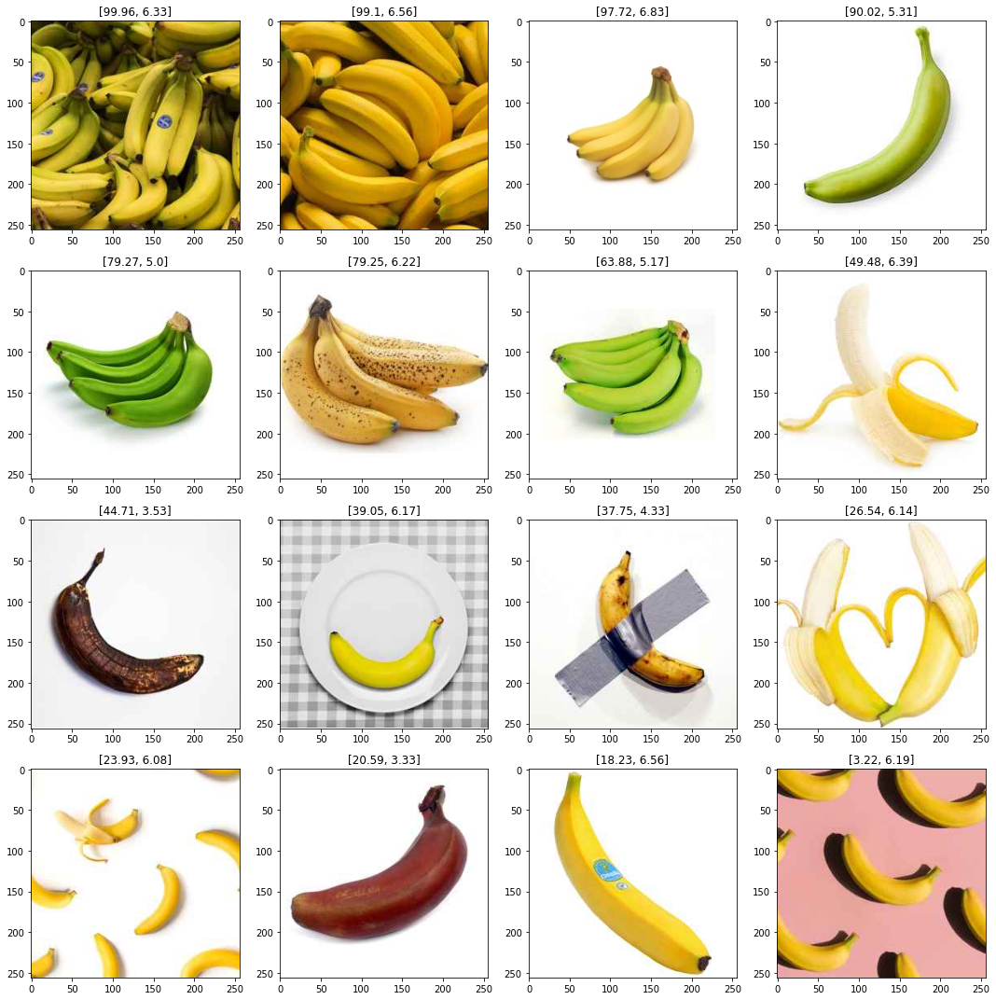

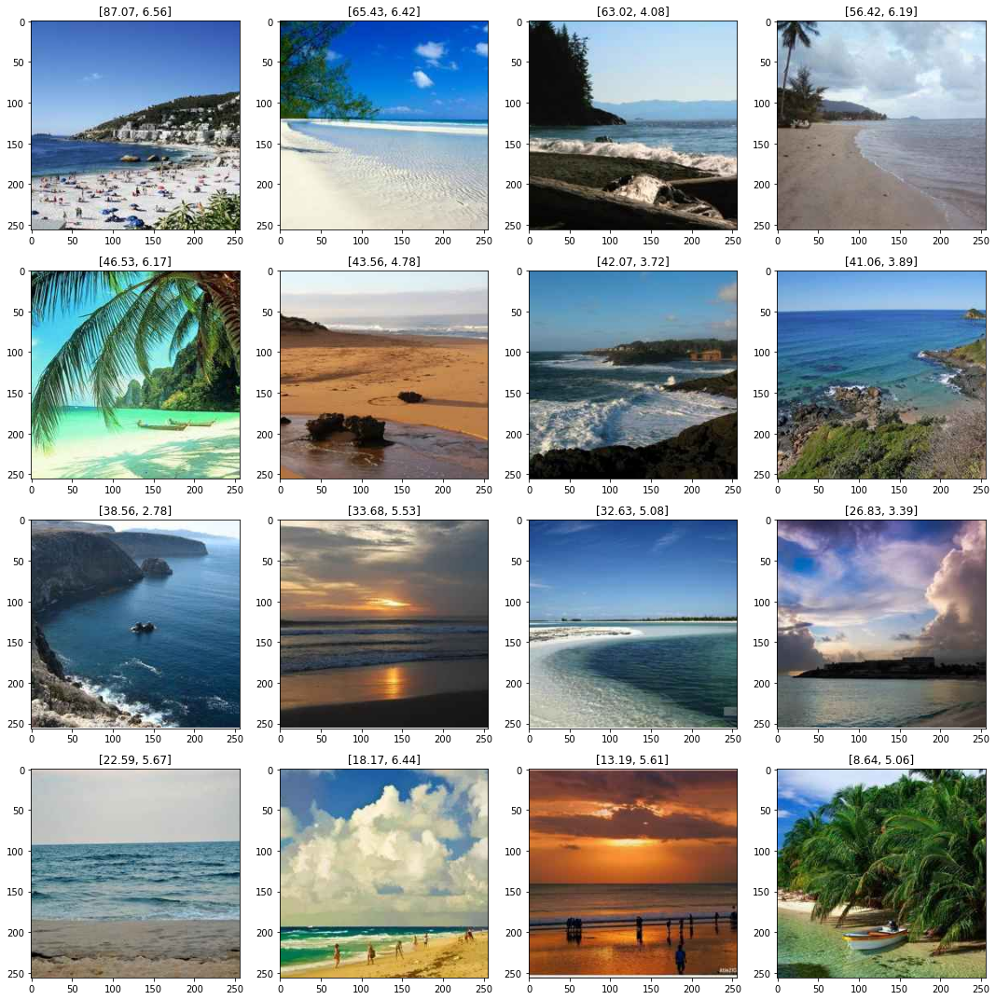

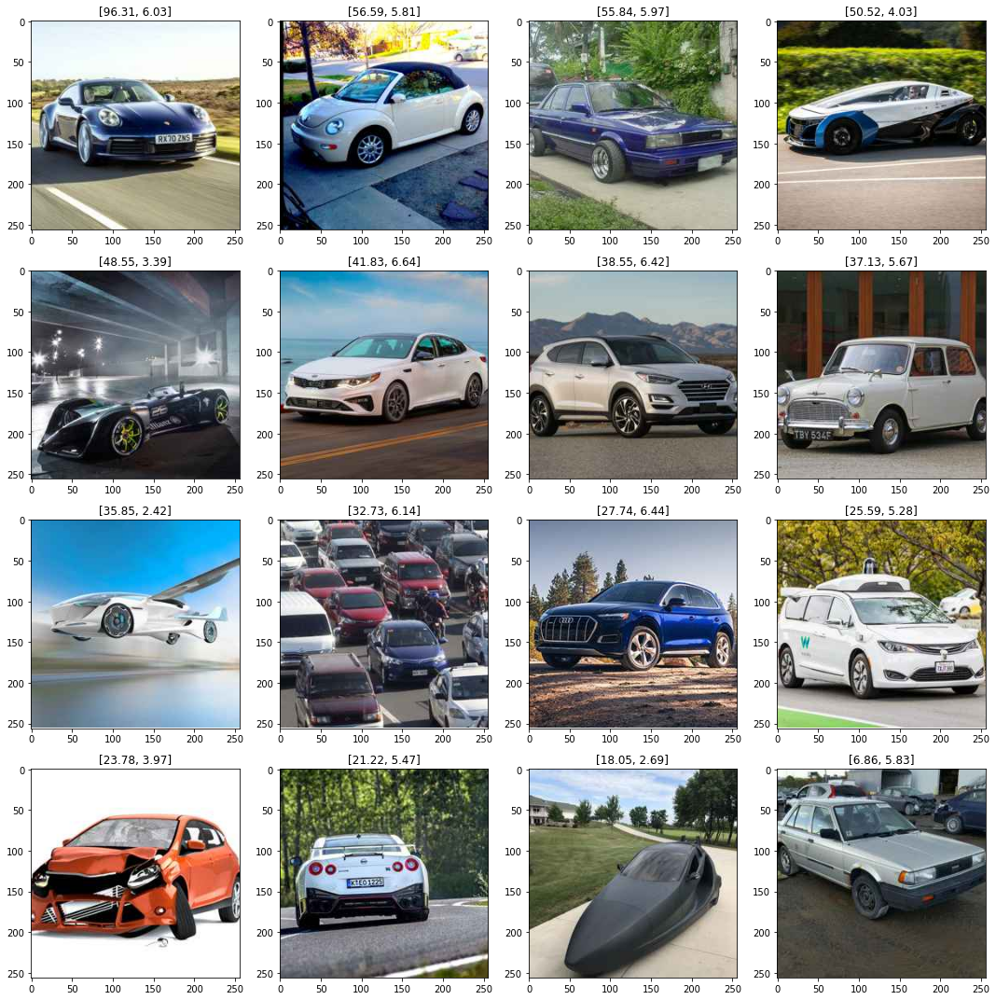

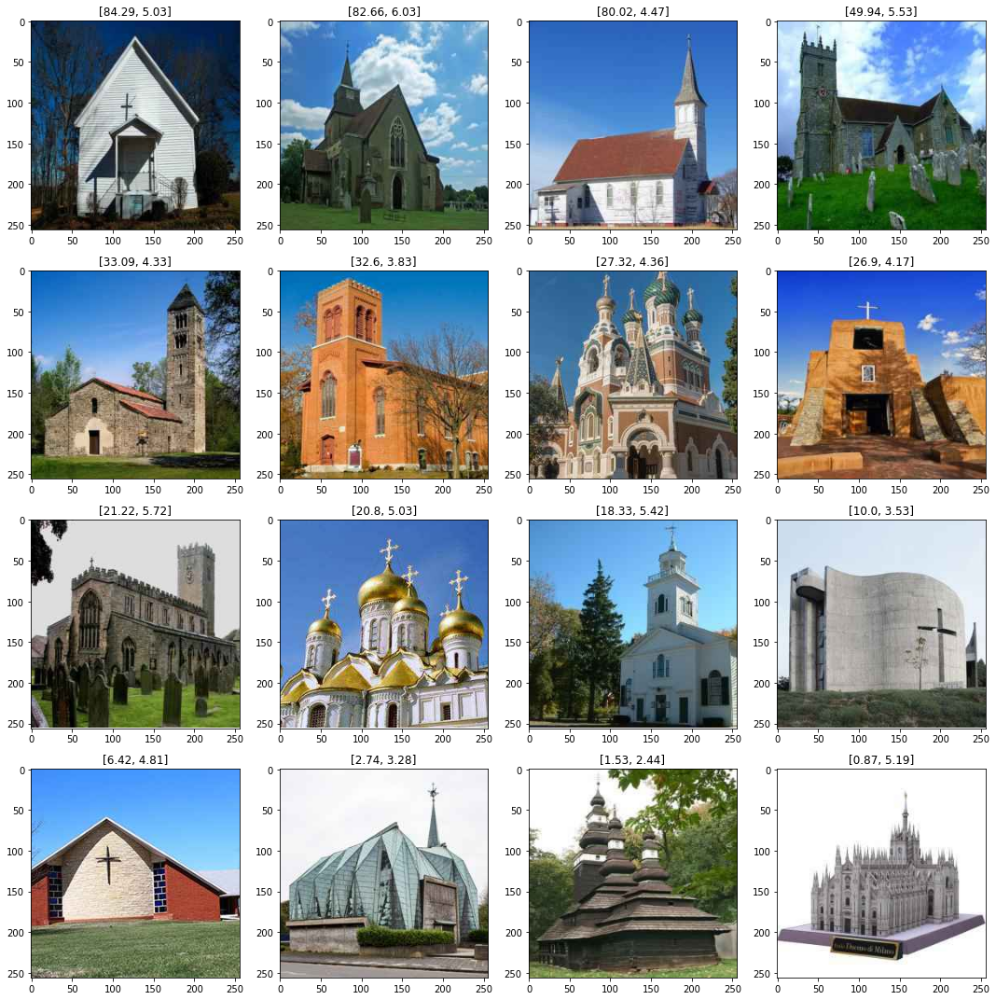

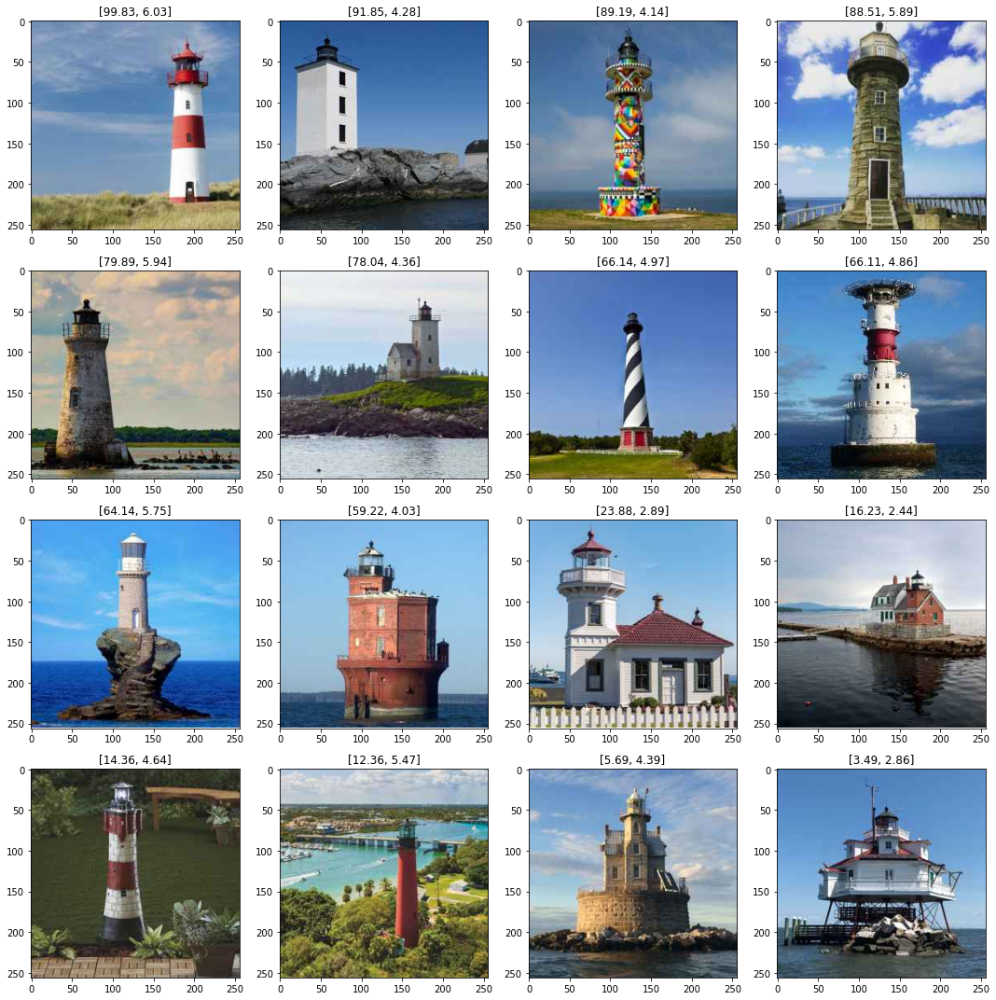

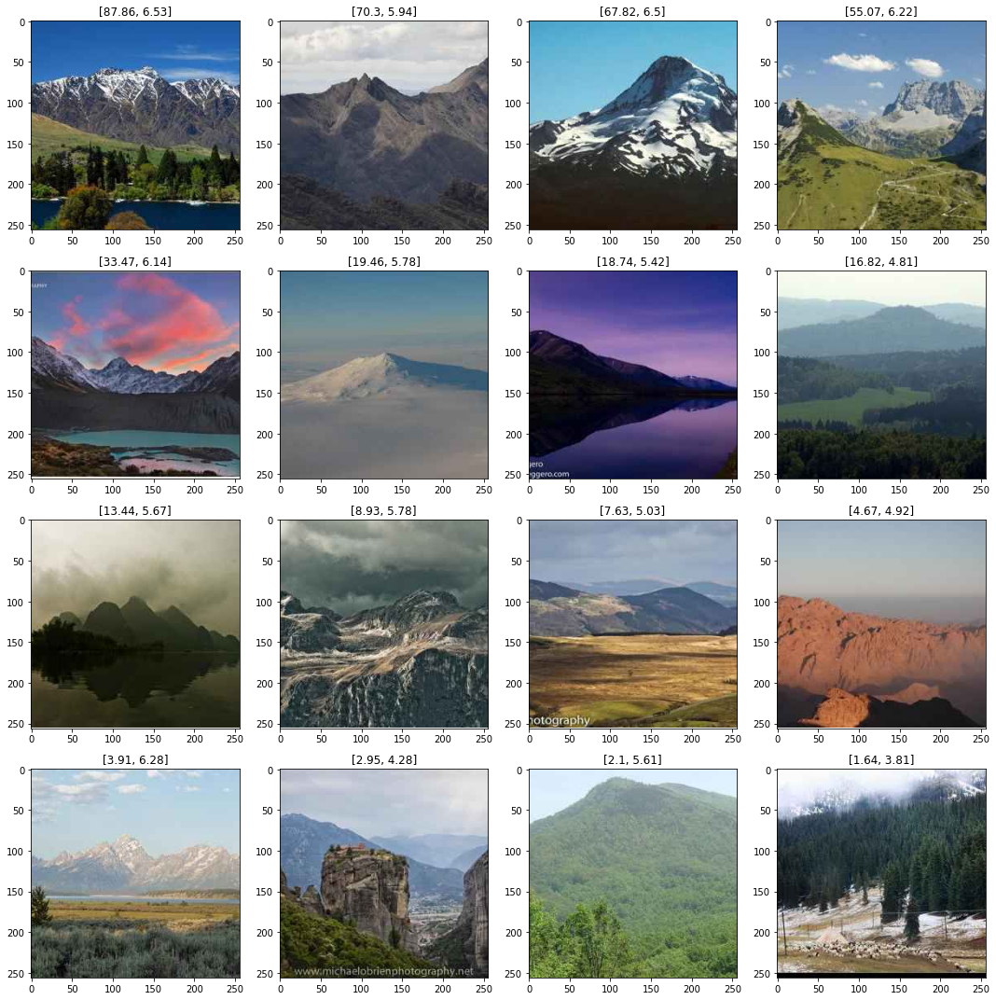

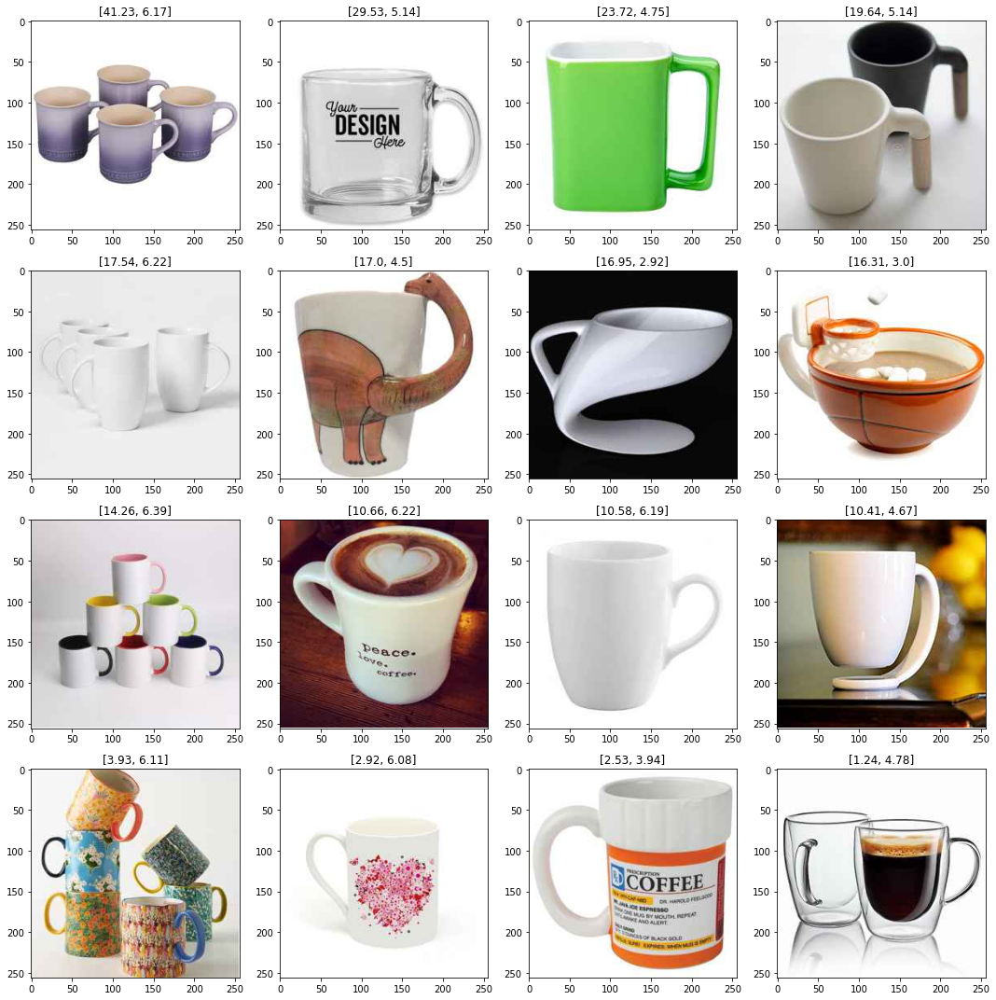

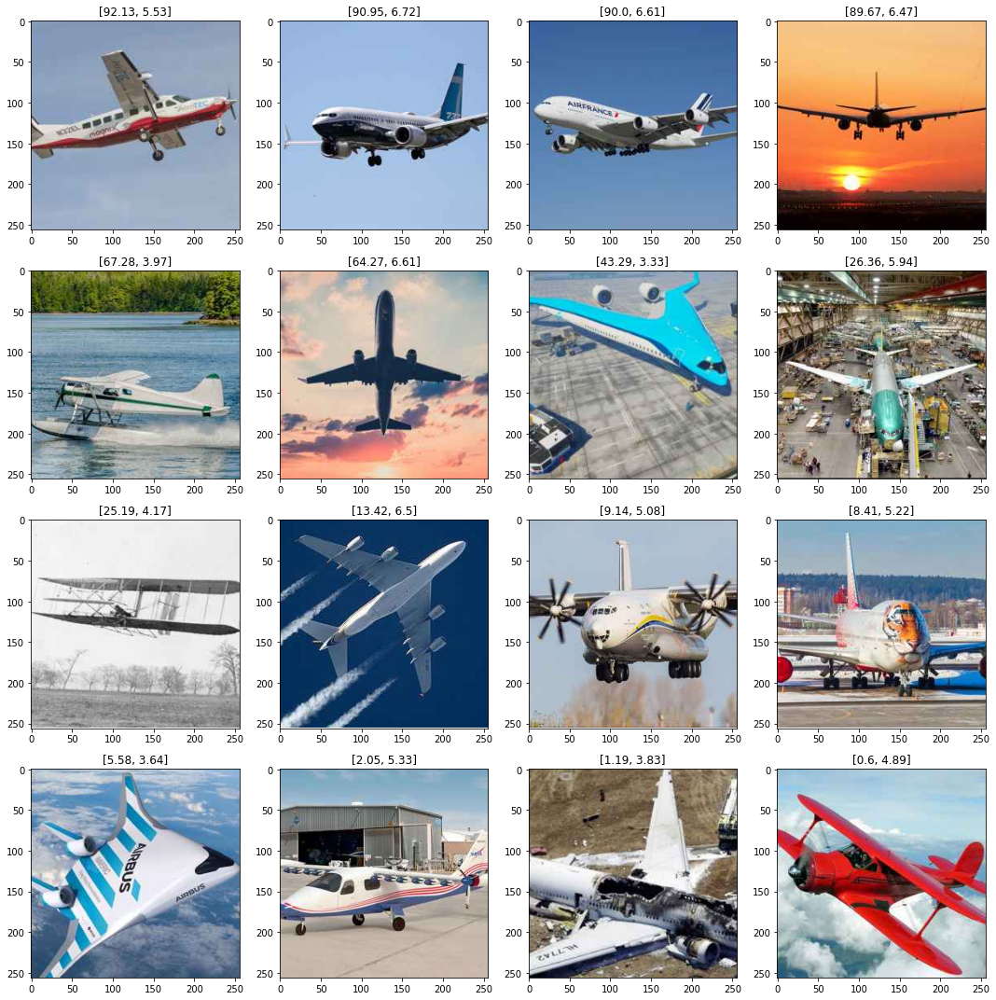

In [95]:
# sort by CNN score
start = 0
for i in range(16, alexnet_df.shape[0] + 1, 16):
    plot_df = alexnet_df.iloc[start:i, :].sort_values('typicality_score', ascending = False)
    plot_df.index = np.array([*range(0,16)])
    plt.figure(figsize = (15,15))
    count = 1
    score=[]
    for j in range(16):
        plt.subplot(4,4,count)
        dir=plot_df['dir'][j]
        score.append([plot_df['typicality_score'][j], round(plot_df['human_score'][j],2)])
        img=Image.open(dir)
        plt.imshow(img)
        plt.title(score[j])
        count += 1
    start = i
    plt.tight_layout()
    plt.savefig('sort_by_cnn_{}'.format(plot_df["type"][0]))
    plt.show()

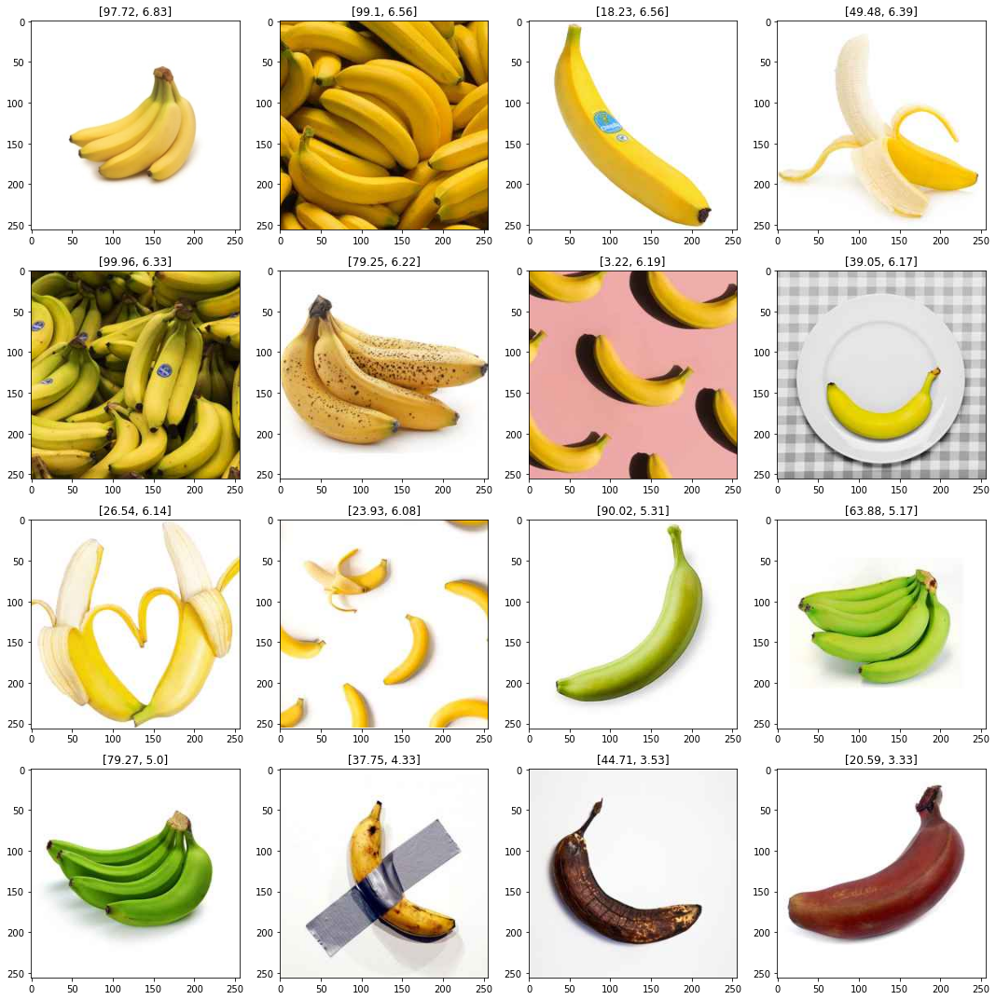

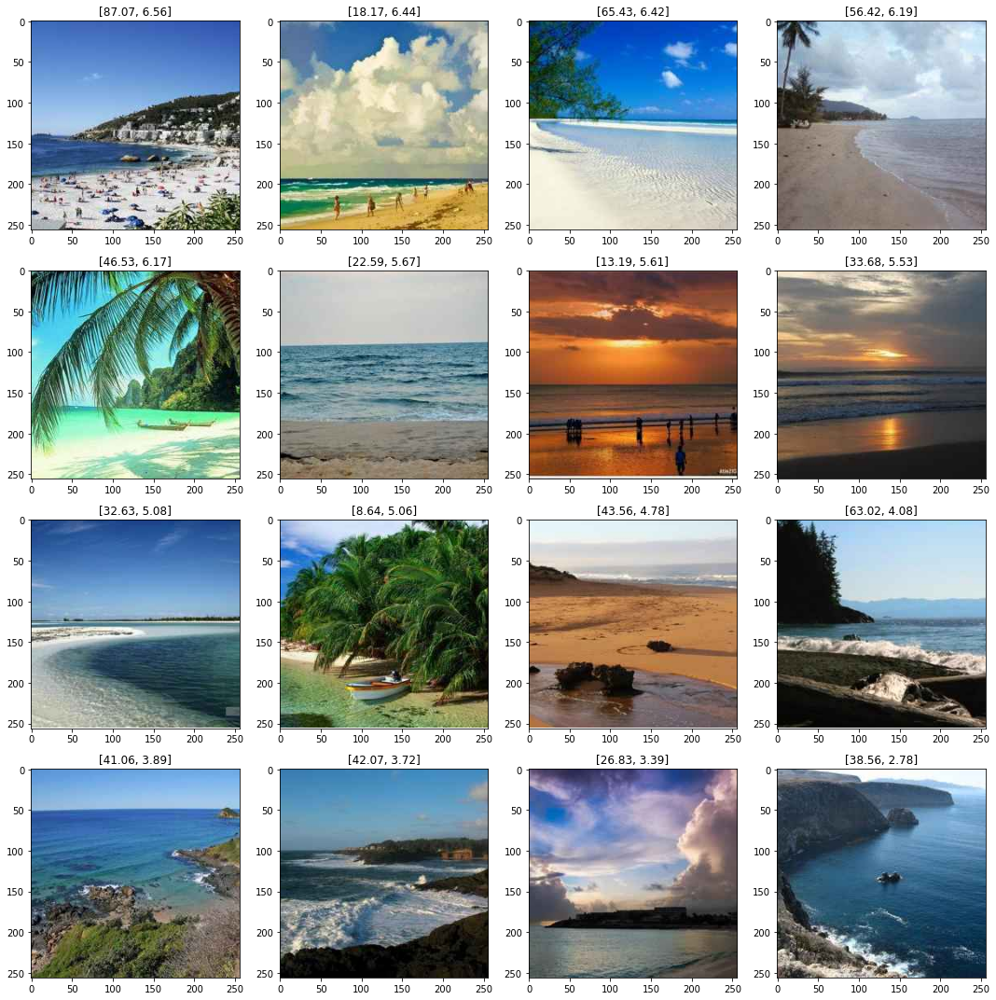

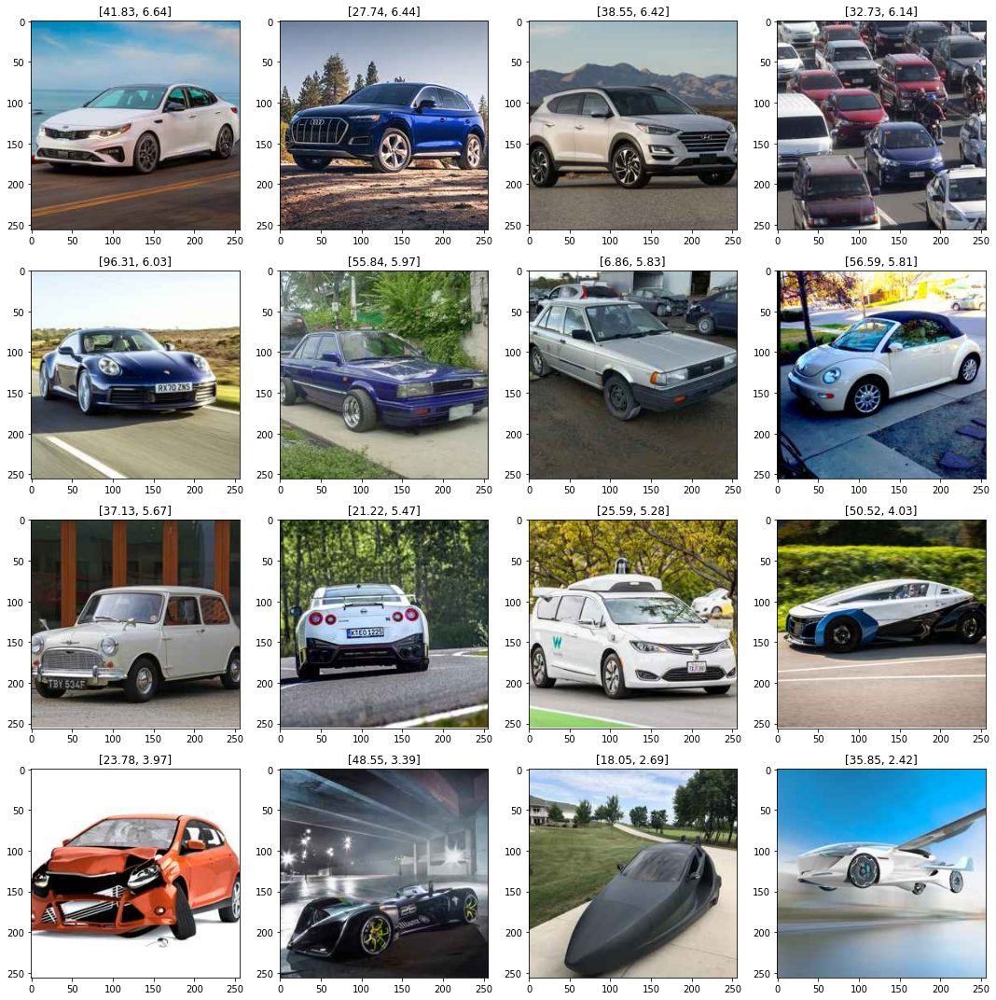

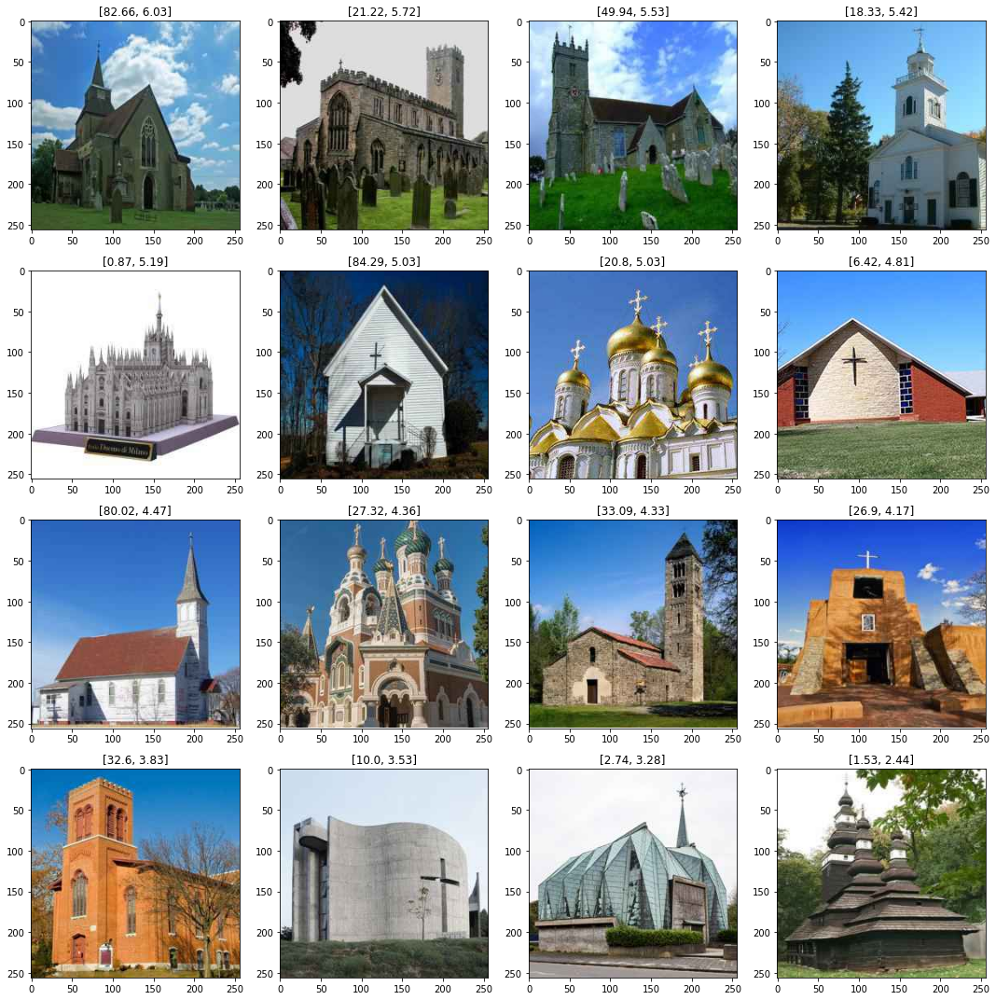

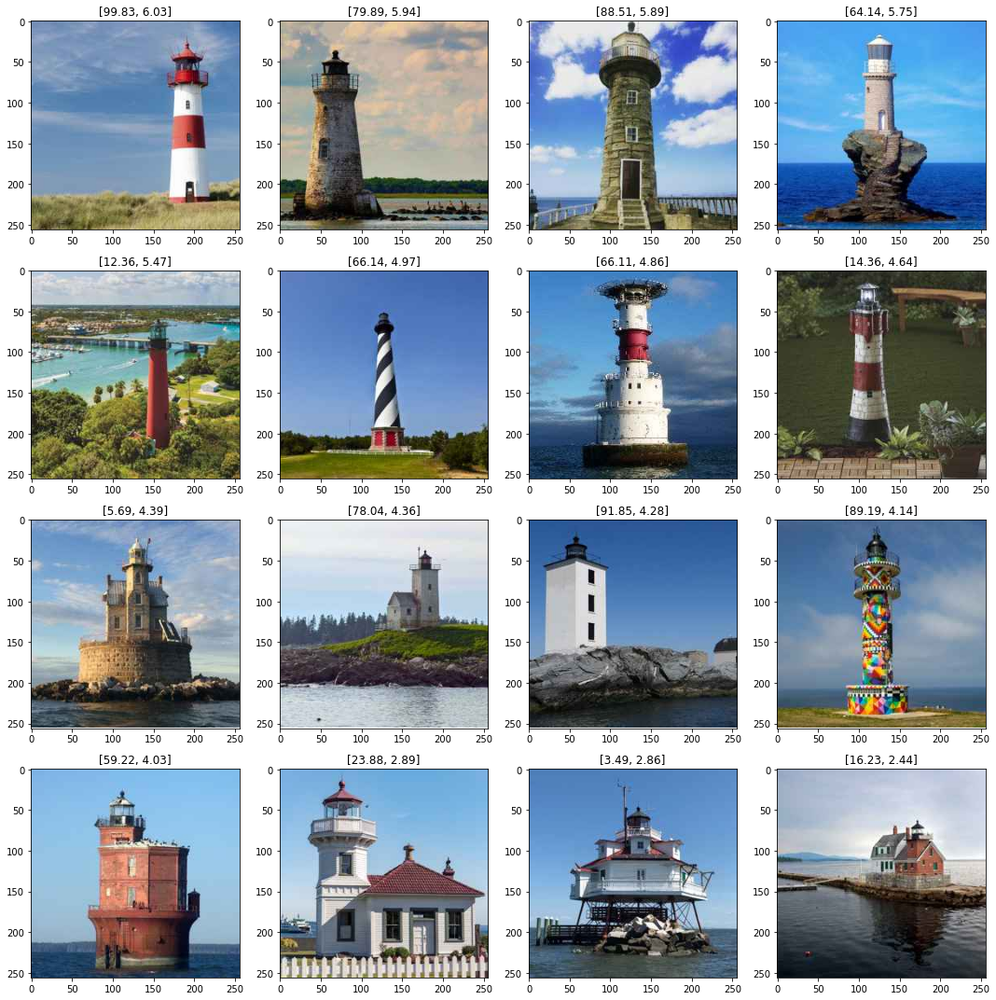

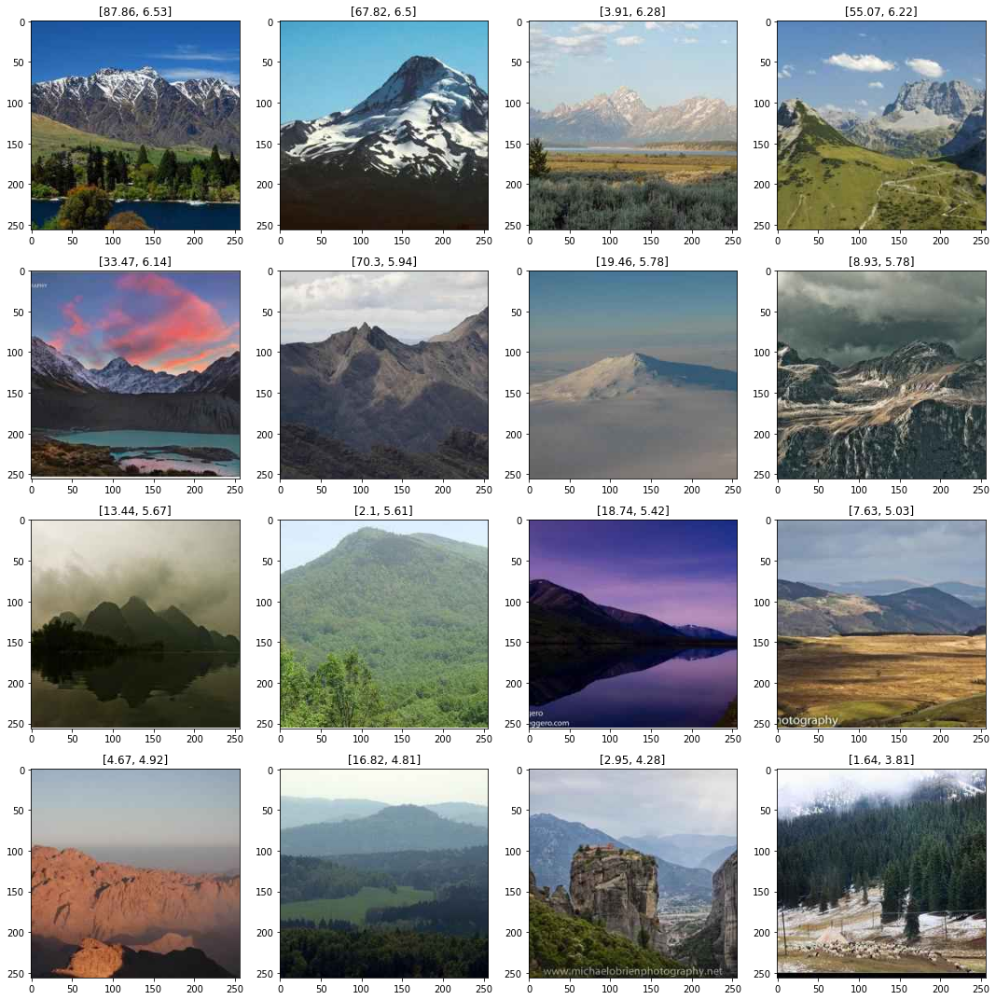

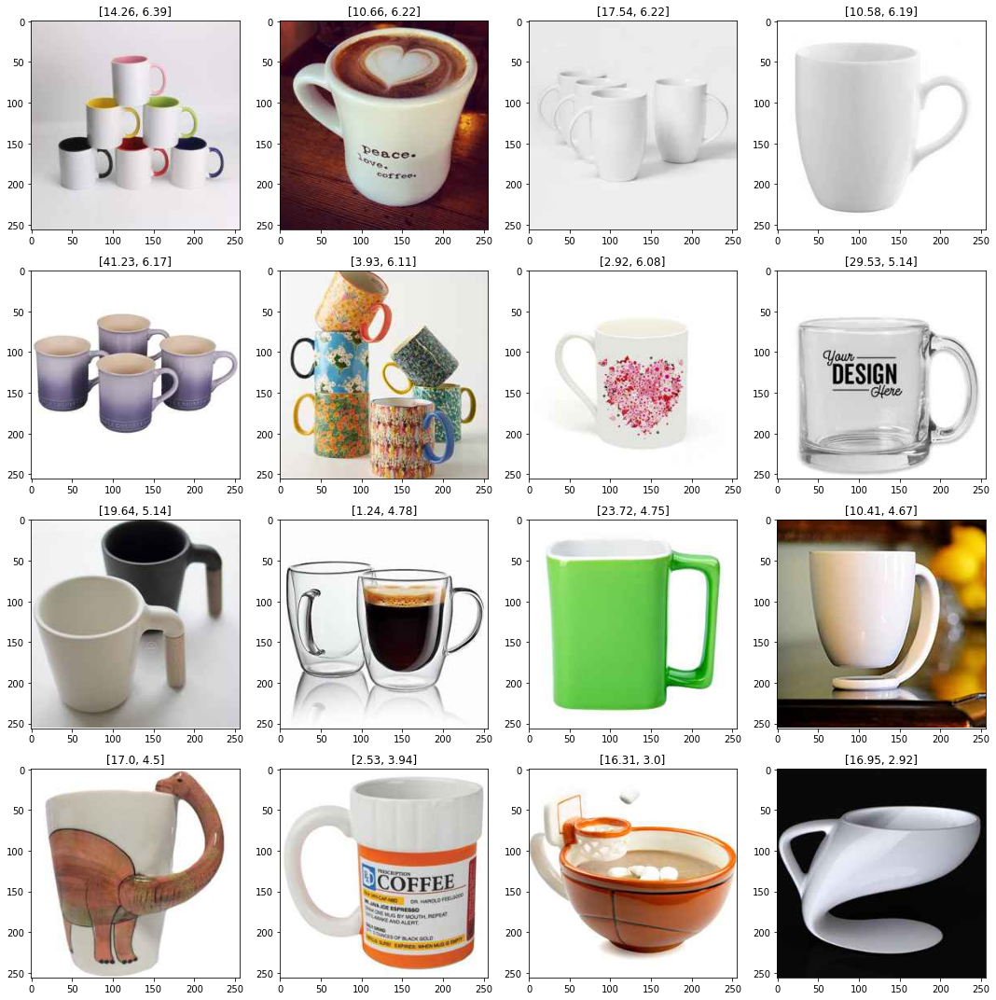

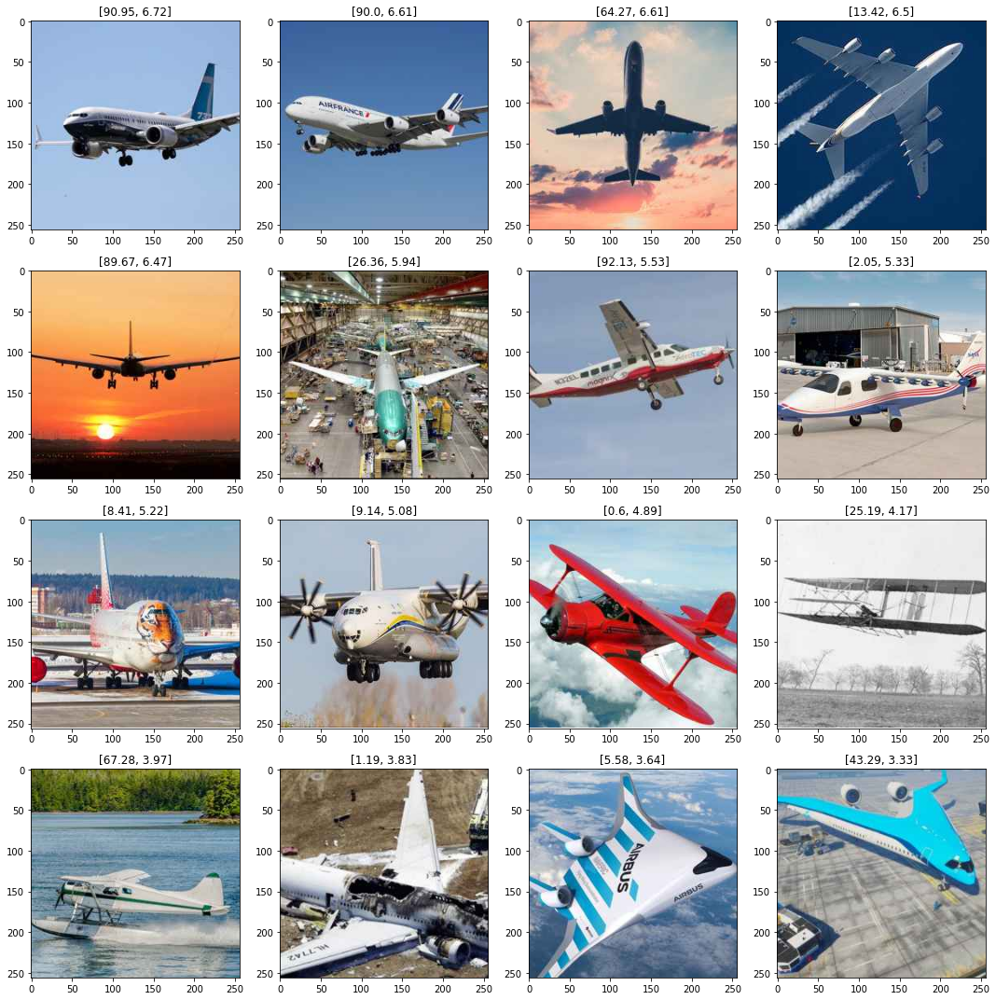

In [96]:
# Sort by human score
start = 0
for i in range(16, alexnet_df.shape[0] + 1, 16):
    plot_df = alexnet_df.iloc[start:i, :].sort_values('human_score', ascending = False)
    plot_df.index = np.array([*range(0,16)])
    plt.figure(figsize = (15,15))
    count = 1
    score=[]
    for j in range(16):
        plt.subplot(4,4,count)
        dir=plot_df['dir'][j]
        score.append([plot_df['typicality_score'][j], round(plot_df['human_score'][j],2)])
        img=Image.open(dir)
        plt.imshow(img)
        plt.title(score[j])
        count += 1
    start = i
    plt.tight_layout()
    plt.savefig('sort_by_human_{}.png'.format(plot_df["type"][0]))
    plt.show()